# CLIENT'S LOAN PREDICTION PROJECT
## Futher Data exploration with Client Segmentation

## Library and Data Import

In [25]:
# Library Import
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from datetime import datetime
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

In [26]:
df = pd.read_csv('F:/JUPYTER/LOAN PREDICTION/loan_data_2007_2014.csv')

C:\Users\una\AppData\Local\Temp\ipykernel_11776\3730658066.py:1: DtypeWarning: Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('F:/JUPYTER/LOAN PREDICTION/loan_data_2007_2014.csv')


### Client Segmentation with Kmeans Clustering Model

We construct an unsupervised model using k-means clustering to perform customer segmentation. This model aims to explore the overall patterns among clients and gain insights into their characteristics.

But before that, we will create a new column called 'Recency'. This column will provide us with information about the duration in years since the borrower's earliest reported credit line was opened.

But the dataset used contains data from 1969, and there are incorrect dates that fall beyond 2023. So, we will only use data from 1990 to 2014 to maintain relevance.

In [27]:
# Make a new column called 'Recency'
df['earliest_cr_line_date'] = pd.to_datetime(df['earliest_cr_line'], format='%b-%y')
df = df[(df['earliest_cr_line_date'].dt.year > 1990) & (df['earliest_cr_line_date'].dt.year <= 2014)]
df['recency'] = (pd.to_datetime(datetime.now().date()) - df['earliest_cr_line_date'])
df['recency'] = (df['recency'].dt.days/365).round(2)

To simplify the identification of clients, we will reclassify the loan status into two categories: 'High Risk' and 'Low Risk'. The 'High Risk' category includes clients with the loan status 'Charged Off', 'Default', 'Does not meet the credit policy. Status:Charged Off', 'Late (16-30 days)', 'Late (31-120 days)', indicating a high risk of default. On the other hand, the 'Low Risk' category includes clients with the loan status 'Current', 'Fully Paid', 'In Grace Period', 'Does not meet the credit policy. Status:Fully Paid', 'Fully Paid', 'In Grace Period', indicating a low risk.

In [28]:
list = []
for index, i in df.iterrows():
    if i['loan_status'] in ['Current', 'Fully Paid', 'In Grace Period', 'Does not meet the credit policy. Status:Fully Paid', 'Fully Paid', 'In Grace Period']:
        list.append('Low Risk')
    else:
        list.append('High Risk')
df['Risk'] = list

In this clustering, we will select features that are considered to represent customers well. 

In grouping clients, we will consider factors such as :

* 'dti'
* 'annual_inc'
* 'int_rate'
* 'loan_amnt'
* 'recency'

Firstly, we need to check if there any multicolinearity by checking the correlation between each features.

Text(0.5, 1.0, 'Correlation plot between features for clustering')

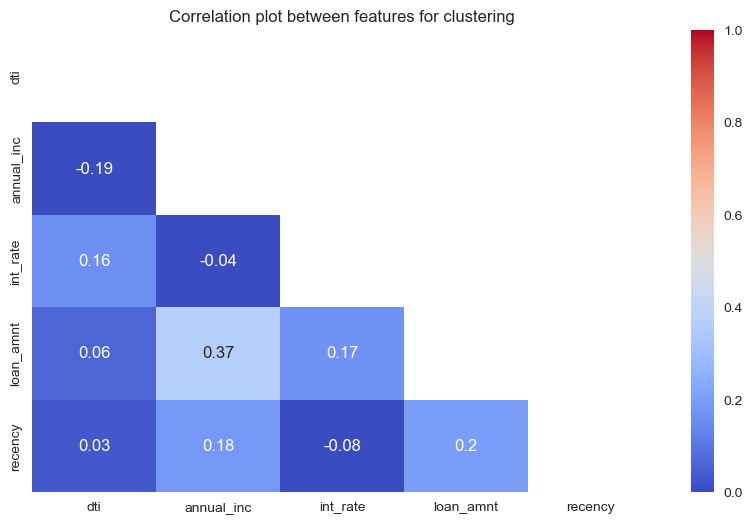

In [29]:
feat = ['dti', 'annual_inc', 'int_rate', 'loan_amnt', 'recency']
plt.figure(figsize=(10, 6))
mask = np.triu(np.ones_like(df[feat].corr()))
dataplot = sns.heatmap(df[feat].corr().round(2), cmap="coolwarm", annot=True, mask=mask, vmin=0, vmax=1)
plt.title('Correlation plot between features for clustering')

There is no feature that has high correlation with other feature.

In [30]:
data_clust = df[['member_id', 'Risk', 'dti', 'annual_inc', 'int_rate', 'loan_amnt', 'recency']]
print('Data for Clustering Shape',data_clust.shape)
data_clust.head()

Data for Clustering Shape (389998, 7)


,member_id,Risk,dti,annual_inc,int_rate,loan_amnt,recency
1,1314167,High Risk,1.00,30000.0,15.27,2500,24.28
2,1313524,Low Risk,8.72,12252.0,15.96,2400,21.69
3,1277178,Low Risk,20.00,49200.0,13.49,10000,27.44
4,1311748,Low Risk,17.94,80000.0,12.69,3000,27.53
5,1311441,Low Risk,11.20,36000.0,7.90,5000,18.68


Then we will check the missing value

In [31]:
print(data_clust.isnull().sum())

member_id     0
Risk          0
dti           0
annual_inc    0
int_rate      0
loan_amnt     0
recency       0
dtype: int64


We will also drop the outlier from this dataset. But first, we need to check the data distribution

Data Shape:  (389998, 7)


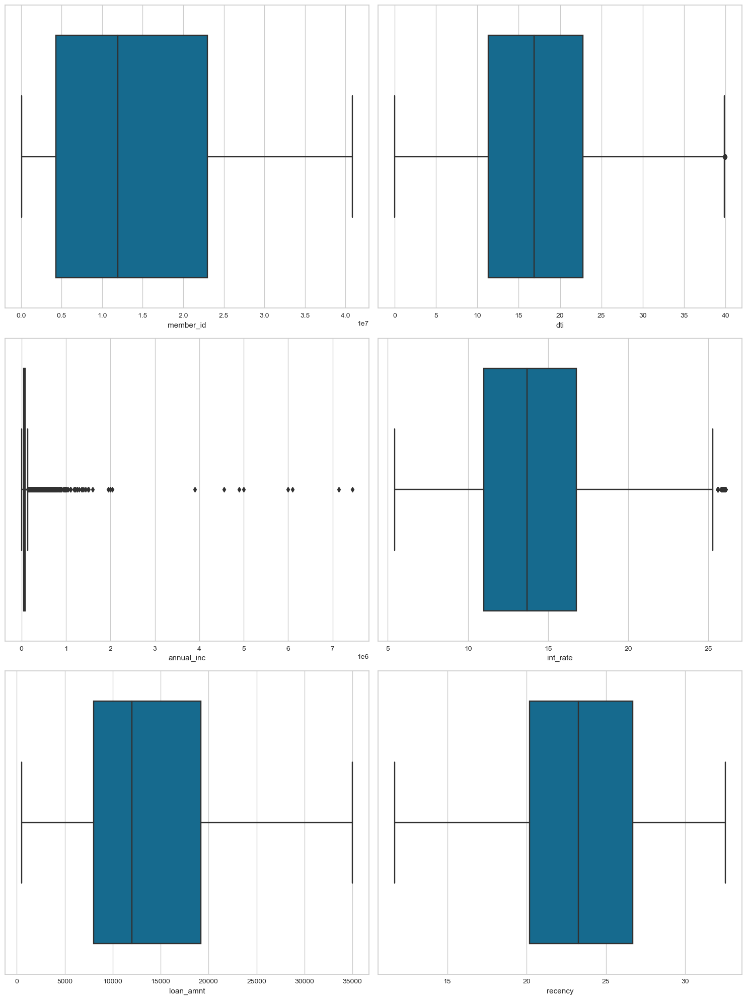

In [32]:
print('Data Shape: ', data_clust.shape)
plt.figure(figsize= (15, 20))
features = data_clust.select_dtypes(['float', 'int']).columns
for i in range(len(features)):
    plt.subplot(3, 2, i+1)
    sns.boxplot(x = data_clust[features[i]])
    plt.tight_layout()

As we know from the boxplot, only annual income feature that has extreme outlier. So we will only handle outlier from this feature.

In [33]:
# Drop the outlier
upper = data_clust['annual_inc'].quantile(0.75) + (data_clust['annual_inc'].quantile(0.7) - data_clust['annual_inc'].quantile(0.25))*1.5
data_clust = data_clust[data_clust['annual_inc'] < upper]

check the data distribution after outlier removal

Data Shape:  (368269, 7)


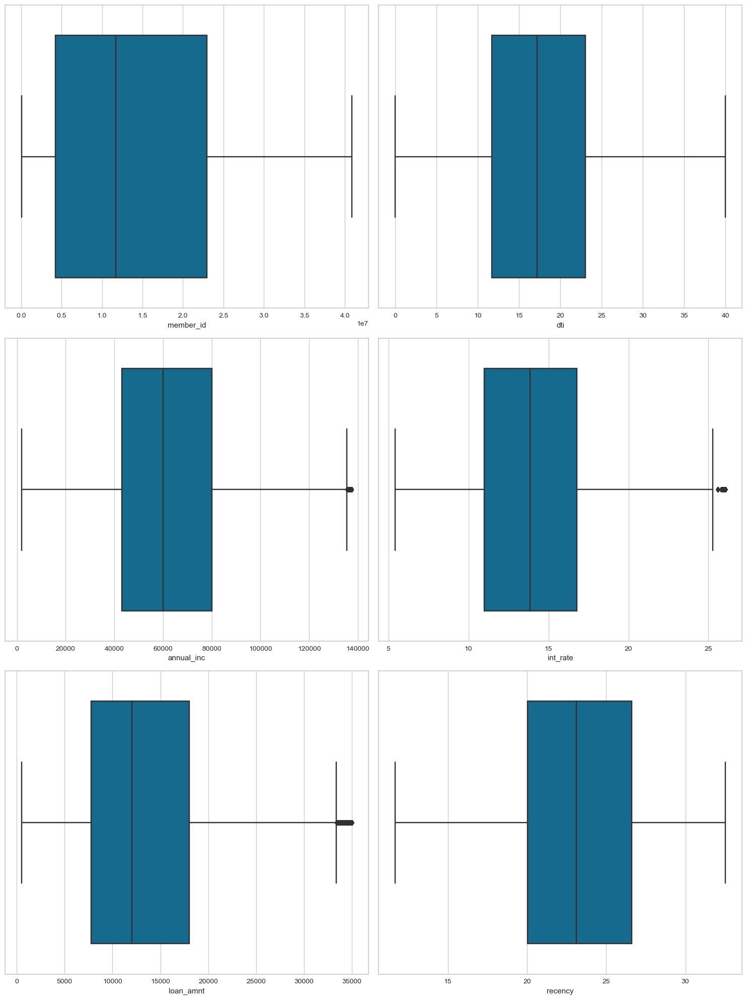

In [34]:
print('Data Shape: ', data_clust.shape)
plt.figure(figsize= (15, 20))
features = data_clust.select_dtypes(['float', 'int']).columns
for i in range(len(features)):
    plt.subplot(3, 2, i+1)
    sns.boxplot(x = data_clust[features[i]])
    plt.tight_layout()

Then we will normalize the data

In [35]:
# normalization with minmaxscaler
minmaxscaler = MinMaxScaler()
data_clust_scaled = data_clust.drop(['member_id', 'Risk'], axis = 1)
data_clust_scaled = minmaxscaler.fit_transform(data_clust_scaled)

To determine the optimal number of clusters or groups for data segmentation, an elbow test will be conducted.

These tests will help identify the ideal number of customer segments.

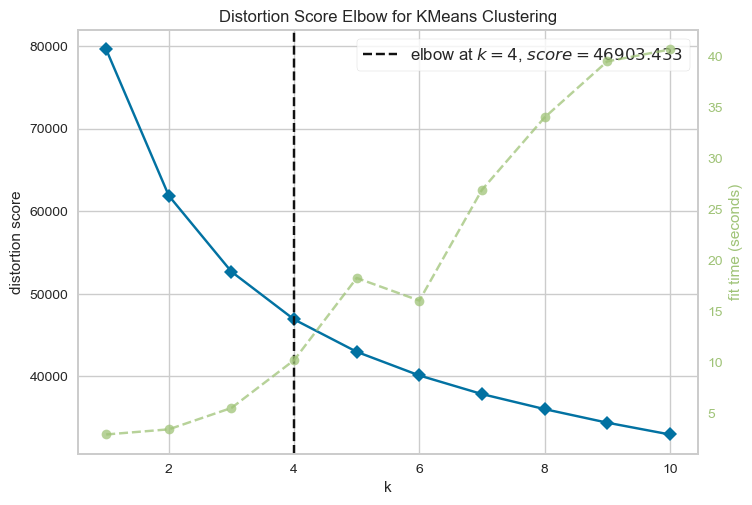

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [36]:
#WSS elbow test
WSS =  KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
visualizer = KElbowVisualizer(WSS, k=(1,11))

visualizer.fit(data_clust_scaled)
visualizer.show()

According to the elbow test, the optimal number of clusters for data segmentation in this dataset is 4.

Then we use the kmeans algorithm for the clustering model

In [37]:
# Clustering model
kmeans = KMeans(n_clusters = 4, init = 'k-means++', n_init = 10, random_state = 42)
kmeans.fit(data_clust_scaled)
data_clust['CLUSTER'] = kmeans.labels_

In [38]:
pcs = PCA(n_components = 2).fit_transform(data_clust_scaled)
pdf = pd.DataFrame(data = pcs, columns = ['pc1', 'pc2'])
pdf['CLUSTER'] = kmeans.labels_

In [39]:
px.scatter(x = pdf['pc1'], y = pdf['pc2'], color = pdf['CLUSTER'], width = 600, height = 500)

From the obtained visualization, it can be observed that the data is well separated based on their clusters.

**Conclusion from the Clustering Model**

In [40]:
data_clust.groupby('CLUSTER').agg({'annual_inc':'mean', 'dti':'mean', 'int_rate':'mean', 'loan_amnt':'median', 'recency':'mean'}).round(2)

,annual_inc,dti,int_rate,loan_amnt,recency
CLUSTER,,,,,
0,48674.48,25.33,15.84,11200.0,23.91
1,47509.75,14.03,13.96,8275.0,18.76
2,87997.15,18.02,16.33,24800.0,24.68
3,74112.33,13.41,10.66,11200.0,25.92


There are 4 obtained clusters :

* **Cluster 0**

This cluster consists of clients with low income but high loan amounts, resulting in a relatively high debt-to-income ratio (DTI). Clients in this group tend to have high interest rates due to their high loan amounts and are likely long-term clients.

* **Cluster 1**

This cluster consists of clients with low annual income and low loan amount, resulting in a low debt-to-income (DTI) ratio. These clients tend to have moderate interest rates and are relatively new compared to other clusters.

* **Cluster 2**

This cluster comprises clients with high annual income and high loan amount, resulting in a high DTI ratio. Clients in this cluster typically have high interest rates and have been with the institution for a longer period of time.

* **Cluster 3**

This cluster consists of clients with high income and low loan amounts, resulting in a low DTI. Clients in this group tend to have low interest rates because of their low loan amounts. 


In [41]:
grouped_cluster = data_clust.groupby(['Risk', 'CLUSTER']).agg(count = ('member_id', 'nunique')).reset_index()

In [42]:
grouped_cluster_plot = px.bar(x = grouped_cluster['CLUSTER'], y = grouped_cluster['count'], color = grouped_cluster['Risk'], color_discrete_map = {'Low Risk':'#4B878B', 'High Risk':'#921416'}, text = grouped_cluster['count'])
grouped_cluster_plot.update_layout(xaxis_title = None, yaxis_title = None)
grouped_cluster_plot.update_layout(title_text='Clients Risk Level From each Cluster', width = 600, height = 500)

The majority of clients are found in Cluster 0 and Cluster 1.

In [43]:
grouped_cluster = grouped_cluster.pivot(index='CLUSTER', columns='Risk', values='count').reset_index().fillna(0)
grouped_cluster['Total Client'] = grouped_cluster['High Risk'] + grouped_cluster['Low Risk']
grouped_cluster['High Risk Rate (%)'] = ((grouped_cluster['High Risk']/grouped_cluster['Total Client'])*100).round(2)
grouped_cluster

Risk,CLUSTER,High Risk,Low Risk,Total Client,High Risk Rate (%)
0,0,14349,77680,92029,15.59
1,1,12044,87928,99972,12.05
2,2,10016,63160,73176,13.69
3,3,6798,96294,103092,6.59


In [44]:
grouped_cluster_sorted = grouped_cluster.sort_values('CLUSTER')
grouped_cluster_plot2 = px.bar(grouped_cluster_sorted, x = 'CLUSTER', y = 'High Risk Rate (%)', color_discrete_sequence = ['firebrick'], text = (grouped_cluster_sorted['High Risk Rate (%)'].astype(str) + '%'), width=500, height=400)
grouped_cluster_plot2.update_layout(title="High Risk Rate from each Clusters (%)",title_font=dict(size=18, color="black"))

As expected, Cluster 1 has the highest risk rate. Clients in Cluster 1 tend to take out high loan amounts despite having low incomes. On the other hand, Cluster 3 has the lowest risk rate. Clients in this cluster tend to take out low loan amounts despite having high incomes.

It is found that clients in Cluster 1 have the highest ratio of high-risk clients. Therefore, it is crucial to give special focus to this particular client segment to prevent  them from defaulting on their payments.